In [1]:
import numpy as np
import cv2
import os
import pickle
import random
import shutil
import sys
import time
import zipfile
from matplotlib.collections import LineCollection
import matplotlib.lines as mlines
import matplotlib.pyplot as plt
#import seaborn as sns
from sklearn.metrics import (
    accuracy_score,
    confusion_matrix,
    f1_score,
    precision_score,
    recall_score,
)
import nn
import random
import torch
import pandas

In [2]:
import pahaw_loader
from pahaw_loader import Stroke, Task
from PahawOfflineSimDataset import PahawOfflineSimDataset, patches_per_image, patch_generator

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


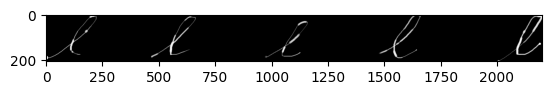

In [4]:
img_path = "tareas_generadas/sujeto94_GT0/tarea2.png"
img = cv2.imread(img_path, 0)
plt.imshow(img, cmap="gray")
plt.show()


In [7]:
def crop_black_columns(img):
    """
    Remove columns tah are completely black (all zeros)
    """
    mask = ~(img == 0).all(axis=0)
    no_black_columns = img[:, mask]
    return no_black_columns

def restore_full_width(img, cropped_img):
    """
    Restore the width of the original image by filling the removed columns.
    If fill_value is None, the cropped image will be repeated (tiled) horizontally.
    Otherwise, the remaining columns are filled with the specified value (e.g., 255 for white).
    """
    full_h, full_w = img.shape
    reduced_h, reduced_w = cropped_img.shape
    n_copies = int(np.ceil(full_w / reduced_w))
    tiled = np.tile(cropped_img, (1, n_copies))[:, :full_w]
    return tiled

def clean_and_refill(img):
    """
    Complete pipeline: remove black columns and restore width.
    If fill_value is None, repeats the cropped image to fill the width.
    If fill_value is specified (e.g., 255), fills the removed area with that value.
    """
    cropped_img = crop_black_columns(img)
    final_result = restore_full_width(img, cropped_img)
    return final_result

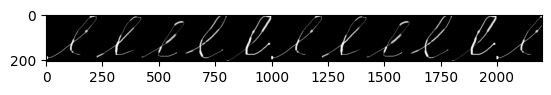

In [8]:
final_image = clean_and_refill(img)
plt.imshow(final_image, cmap="gray", vmin=0, vmax=255)
plt.show()

In [4]:
def read_csv(task_file_path=None, subject_id=1, task_num=2):
    task_strokes_list = []
    all_coords = []
    if os.path.exists(task_file_path):
        with open(task_file_path, encoding="utf-8") as task_file:
            # Se salta la primera línea.
            task_file.readline()
            from_on_air = True
            while True:
                line = task_file.readline()
                if not line:
                    break
                coordinate = (
                    int(line.split()[1]),
                    int(line.split()[0]),
                    int(line.split()[2]),
                    int(line.split()[3]),
                    int(line.split()[4]),
                    int(line.split()[5]),
                    int(line.split()[6]),
                )
                all_coords.append(coordinate)
                # Si la coordenada está sobre el papel.
                if line.split()[3] == "1":
                    if from_on_air:
                        task_strokes_list.append(Stroke(coordinate))
                        from_on_air = False
                    else:
                        task_strokes_list[-1].append(coordinate)
                else:
                    from_on_air = True
    else:
        print(f"Archivo no encontrado: {task_file_path}, se omite.")
    if task_strokes_list:  # Solo si hay trazos
        new_task = Task(subject_id, task_num, task_strokes_list, all_coords)
        new_task.plot_task(subdir=f"sujeto{999}_GT{0}")
    else:
        print(f"Tarea vacía para Sujeto {subject_id}, Tarea {task_num}, se omite.")
    return new_task



In [ ]:
#Read corpus pahaw xslx
pahaw_file_path = os.path.join("PaHaW", "PaHaW_files", "corpus_PaHaW.xlsx")
pahaw_dataframe = pandas.read_excel(pahaw_file_path)

#random id and task
subject_id = 27
task_num = 5

#Read all csvs
task_file_path_start = os.path.join("PaHaW", "PaHaW_public")
task_file_path_end = "_1.svc"
task_file_path_mid = os.path.join(
    f"{subject_id:05d}", f"{subject_id:05d}__{task_num}"
)
final_task_file_path = os.path.join(
    task_file_path_start, task_file_path_mid + task_file_path_end
)

random_task = read_csv(final_task_file_path,subject_id, task_num)
print(final_task_file_path)

PaHaW/PaHaW_public/00027/00027__1_1.svc


In [4]:
subjects_pd_status_years, subjects_tasks = pahaw_loader.load()

Archivo no encontrado: PaHaW/PaHaW_public/00017/00017__8_1.svc, se omite.
Tarea vacía para Sujeto 17, Tarea 8, se omite.
Archivo no encontrado: PaHaW/PaHaW_public/00027/00027__8_1.svc, se omite.
Tarea vacía para Sujeto 27, Tarea 8, se omite.
Archivo no encontrado: PaHaW/PaHaW_public/00061/00061__1_1.svc, se omite.
Tarea vacía para Sujeto 61, Tarea 1, se omite.
Archivo no encontrado: PaHaW/PaHaW_public/00080/00080__1_1.svc, se omite.
Tarea vacía para Sujeto 80, Tarea 1, se omite.
Archivo no encontrado: PaHaW/PaHaW_public/00089/00089__1_1.svc, se omite.
Tarea vacía para Sujeto 89, Tarea 1, se omite.


In [20]:
all_keys = subjects_tasks.keys()

In [22]:
print(all_keys)

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 36, 39, 40, 41, 43, 44, 48, 49, 51, 52, 53, 54, 55, 57, 60, 61, 62, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 80, 82, 83, 84, 85, 87, 89, 90, 91, 92, 94, 95, 96, 97, 98])


In [23]:
for i in all_keys:
    random_task = subjects_tasks[i].get(8)
    if random_task is not None:
        print(random_task.all_coords)
    else:
        print(i)

[(0.0471967057332911, 0.7365269461077845, 0.0, 1.0, 0.3547619047619048, 0.7005494505494505, 0.0283203125), (0.04751346214760849, 0.7405189620758483, 0.00038776866829160205, 1.0, 0.3547619047619048, 0.7005494505494505, 0.0439453125), (0.04751346214760849, 0.7405189620758483, 0.0008309328606248615, 1.0, 0.3547619047619048, 0.7005494505494505, 0.0556640625), (0.04783021856192588, 0.7425149700598802, 0.0012187015289164636, 1.0, 0.3547619047619048, 0.7005494505494505, 0.06640625), (0.04814697497624327, 0.7445109780439122, 0.001661865721249723, 1.0, 0.3547619047619048, 0.7005494505494505, 0.07421875), (0.048463731390560656, 0.7465069860279441, 0.0020496343895413252, 1.0, 0.3547619047619048, 0.7005494505494505, 0.076171875), (0.04878048780487805, 0.7465069860279441, 0.0024927985818745846, 1.0, 0.3547619047619048, 0.7005494505494505, 0.0751953125), (0.04909724421919544, 0.7485029940119761, 0.0028805672501661865, 1.0, 0.3547619047619048, 0.7005494505494505, 0.0751953125), (0.04909724421919544, 

In [ ]:
print(subjects_tasks.keys())
h_id_list = []
pd_id_list = []
subjects_ids = list(subjects_tasks.keys())
for subject_id in subjects_ids:
    if subjects_pd_status_years[subject_id][0] == 0:
        h_id_list.append(subject_id)
    else:
        pd_id_list.append(subject_id)
print(h_id_list)
print(pd_id_list)
print(h_id_list)
print(pd_id_list)
print(len(h_id_list))
print(len(pd_id_list))

validate_id_list = h_id_list[:7]
train_id_list = h_id_list[7:]
validate_id_list.extend(pd_id_list[:6])
train_id_list.extend(pd_id_list[6:])

overfit_id_list = []
for i, val in enumerate(h_id_list):
    overfit_id_list.append(val)
    if i < len(pd_id_list):
        overfit_id_list.append(pd_id_list[i])
if len(pd_id_list) > len(h_id_list):
    overfit_id_list.extend(pd_id_list[len(h_id_list):])
print(overfit_id_list)


dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 36, 39, 40, 41, 43, 44, 48, 49, 51, 52, 53, 54, 55, 57, 60, 61, 62, 66, 67, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 80, 82, 83, 84, 85, 87, 89, 90, 91, 92, 94, 95, 96, 97, 98])
[26, 27, 28, 29, 30, 31, 32, 39, 40, 41, 49, 51, 52, 57, 60, 61, 62, 66, 67, 69, 70, 71, 72, 73, 76, 82, 83, 84, 85, 87, 89, 90, 91, 92, 94, 95, 96, 97]
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 25, 33, 34, 36, 43, 44, 48, 53, 54, 55, 74, 75, 77, 78, 80, 98]
[52, 66, 92, 67, 60, 72, 29, 95, 30, 85, 32, 76, 41, 69, 71, 91, 73, 51, 39, 97, 49, 90, 62, 27, 31, 82, 70, 40, 94, 61, 83, 87, 57, 26, 89, 84, 28, 96]
[15, 20, 75, 22, 77, 33, 4, 78, 5, 43, 7, 36, 10, 23, 25, 74, 34, 14, 8, 80, 13, 53, 19, 2, 6, 24, 9, 54, 18, 44, 17, 16, 1, 55, 48, 3, 98]
38
37
[52, 15, 66, 20, 92, 75, 67, 22, 60, 77, 72, 33, 29, 4, 95, 78, 30, 5, 85, 43, 32, 7, 76, 36, 41, 10, 69,

: 

In [ ]:
subjects_ids = list(subjects_tasks.keys())
for subject_id in subjects_ids:
    for task_number in range(2, 9):
        task = subjects_tasks[subject_id].get(task_number)
        if task is not None:
            print(np.average(task.getCanvases()['pressure']))

0.01356021923207555
0.020881069763599436
0.02400795577156257
0.04282916752688277
0.020867770355999002
0.030000075549293227
0.022772639921541472
0.03551308790217155
0.027310034159496076
0.02951543788855946
0.048503050353697716
0.027532426540424742
0.045527452311089185
0.03139809506924591
0.029680183213008512
0.03421123995645396
0.03942397835294514
0.04946737821333984
0.02846565130999337
0.03394378032002364
0.035010600699364895
0.03183810424705462
0.024418739005255652
0.0223469872440126
0.043336426629792146
0.021956360310761362
0.018237736280281792
0.027768160181053353
0.03968291220614225
0.03874443388775082
0.03583172518926107
0.0574924234700235
0.05036767985223198
0.06670698012139858
0.03982009089311807
0.032613225701223214
0.03514084089166389
0.045422488116360314
0.07520117891674567
0.035408150540207045
0.05023933795711002
0.036837795898768996
0.03581291178117985
0.03302925095236007
0.03908015609516874
0.06309512754857986
0.04055744423266782
0.04361882454247118
0.036489429986358735
0.

: 

In [21]:
random_task = subjects_tasks[1].get(2)
stroke_canvas = random_task.getCanvases()['stroke']
png_img = (stroke_canvas * 255).astype(np.uint8)
cv2.imwrite("random_stroke.png", png_img)

True

In [23]:
print(np.max(stroke_canvas))

0.9959828528235852


In [9]:
subjects_ids = list(subjects_tasks.keys())
data_label_img = []
for subject_id in subjects_ids:
    for task_number in range(2, 9):
        task = subjects_tasks[subject_id].get(task_number)
        if task is not None:
            data_label_img.append(
                (
                    task,
                    subjects_pd_status_years[subject_id][0]
                 )
            )
pahaw_offline_dataset = PahawOfflineSimDataset(data_label_img, device=device)

In [10]:
print(len(pahaw_offline_dataset))

523


In [6]:
def plot_patches(patches: list, npatches_per_plot = 50):
    fig, axes = plt.subplots(1, npatches_per_plot, figsize = (12,4))
    for i in range(len(patches)):
        patch_np = patches[i].squeeze(0).numpy()  # (H, W)

        # Escalar si hace falta (está normalizado o en float)
        patch_uint8 = (patch_np * 255).astype('uint8') if patch_np.max() <= 1 else patch_np.astype('uint8')
        if i < npatches_per_plot:
            axes[i].imshow(patch_uint8, cmap='gray')
            axes[i].axis('off')
        #cv2.imwrite(f"tareas_generadas/patch{i}.png", patch_uint8)
    plt.show("patches_plot.png")

In [8]:
patches, label = pahaw_offline_dataset[0]

torch.Size([1, 672, 4600])


In [14]:
plt.imshow(patches[100].squeeze(0).numpy(), cmap='gray')
plt.show()

IndexError: list index out of range

torch.Size([1, 672, 200])


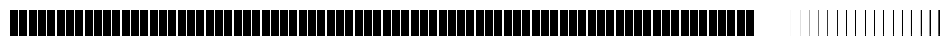

In [27]:
print(patches[0].shape)
plot_patches(patches, 100)

In [ ]:
milista = [i for i in range(0,76)]
print(milista)